In [1]:
#import necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns 
from sklearn import preprocessing
from datetime import datetime 
import plotly.express as ex


In [2]:
data=pd.read_csv("prosperLoanData.csv")
data.head(10)


,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,...,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,...,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,...,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,...,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,...,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20
5,0F05359734824199381F61D,1074836,2013-12-14 08:26:37.093000000,NaN,60,Current,NaN,0.15425,0.1314,0.1214,...,-25.33,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
6,0F0A3576754255009D63151,750899,2013-04-12 09:52:56.147000000,NaN,36,Current,NaN,0.31032,0.2712,0.2612,...,-22.95,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
7,0F1035772717087366F9EA7,768193,2013-05-05 06:49:27.493000000,NaN,36,Current,NaN,0.23939,0.2019,0.1919,...,-69.21,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
8,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.07620,0.0629,0.0529,...,-16.77,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
9,0F043596202561788EA13D5,1023355,2013-12-02 10:43:39.117000000,NaN,36,Current,NaN,0.07620,0.0629,0.0529,...,-16.77,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1


In [3]:

data.shape

(113937, 81)

In [4]:

data.columns 

Index(['ListingKey', 'ListingNumber', 'ListingCreationDate', 'CreditGrade',
       'Term', 'LoanStatus', 'ClosedDate', 'BorrowerAPR', 'BorrowerRate',
       'LenderYield', 'EstimatedEffectiveYield', 'EstimatedLoss',
       'EstimatedReturn', 'ProsperRating (numeric)', 'ProsperRating (Alpha)',
       'ProsperScore', 'ListingCategory (numeric)', 'BorrowerState',
       'Occupation', 'EmploymentStatus', 'EmploymentStatusDuration',
       'IsBorrowerHomeowner', 'CurrentlyInGroup', 'GroupKey',
       'DateCreditPulled', 'CreditScoreRangeLower', 'CreditScoreRangeUpper',
       'FirstRecordedCreditLine', 'CurrentCreditLines', 'OpenCreditLines',
       'TotalCreditLinespast7years', 'OpenRevolvingAccounts',
       'OpenRevolvingMonthlyPayment', 'InquiriesLast6Months', 'TotalInquiries',
       'CurrentDelinquencies', 'AmountDelinquent', 'DelinquenciesLast7Years',
       'PublicRecordsLast10Years', 'PublicRecordsLast12Months',
       'RevolvingCreditBalance', 'BankcardUtilization',
       'Availa

In [5]:

# To get the number of null values in each feature ( missing values )
for feature in data :
    print( feature , " : " , data[feature].isna().sum() )

ListingKey  :  0
ListingNumber  :  0
ListingCreationDate  :  0
CreditGrade  :  84984
Term  :  0
LoanStatus  :  0
ClosedDate  :  58848
BorrowerAPR  :  25
BorrowerRate  :  0
LenderYield  :  0
EstimatedEffectiveYield  :  29084
EstimatedLoss  :  29084
EstimatedReturn  :  29084
ProsperRating (numeric)  :  29084
ProsperRating (Alpha)  :  29084
ProsperScore  :  29084
ListingCategory (numeric)  :  0
BorrowerState  :  5515
Occupation  :  3588
EmploymentStatus  :  2255
EmploymentStatusDuration  :  7625
IsBorrowerHomeowner  :  0
CurrentlyInGroup  :  0
GroupKey  :  100596
DateCreditPulled  :  0
CreditScoreRangeLower  :  591
CreditScoreRangeUpper  :  591
FirstRecordedCreditLine  :  697
CurrentCreditLines  :  7604
OpenCreditLines  :  7604
TotalCreditLinespast7years  :  697
OpenRevolvingAccounts  :  0
OpenRevolvingMonthlyPayment  :  0
InquiriesLast6Months  :  697
TotalInquiries  :  1159
CurrentDelinquencies  :  697
AmountDelinquent  :  7622
DelinquenciesLast7Years  :  990
PublicRecordsLast10Years  : 

In [6]:
data["LoanCurrentDaysDelinquent"].unique()

array([   0,    3,  140, ...,  916, 2349, 1081], dtype=int64)

In [7]:
data["LoanStatus"] = data["LoanCurrentDaysDelinquent"] > 180
data["LoanStatus"] = data["LoanStatus"].replace({True: 0, False: 1})
data["LoanStatus"].unique()

array([1, 0], dtype=int64)

In [8]:
data.duplicated().sum()

0

In [9]:
data.drop_duplicates(inplace=True)
data.duplicated().sum()

0

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113937 entries, 0 to 113936
Data columns (total 81 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   ListingKey                           113937 non-null  object 
 1   ListingNumber                        113937 non-null  int64  
 2   ListingCreationDate                  113937 non-null  object 
 3   CreditGrade                          28953 non-null   object 
 4   Term                                 113937 non-null  int64  
 5   LoanStatus                           113937 non-null  int64  
 6   ClosedDate                           55089 non-null   object 
 7   BorrowerAPR                          113912 non-null  float64
 8   BorrowerRate                         113937 non-null  float64
 9   LenderYield                          113937 non-null  float64
 10  EstimatedEffectiveYield              84853 non-null   float64
 11  EstimatedLoss

In [11]:
data['ListingCreationDate']=pd.to_datetime(data['ListingCreationDate'])
data['ListingCreationDate'].unique()

array(['2007-08-26T19:09:29.263000000', '2014-02-27T08:28:07.900000000',
       '2007-01-05T15:00:47.090000000', ...,
       '2013-12-13T05:49:12.703000000', '2011-11-14T13:18:26.597000000',
       '2014-01-15T09:27:37.657000000'], dtype='datetime64[ns]')

In [12]:
data['ListingCreationDate_date_day']=data['ListingCreationDate'].dt.day
data['ListingCreationDate_date_month']=data['ListingCreationDate'].dt.month
data['ListingCreationDate_date_year']=data['ListingCreationDate'].dt.year
data['ListingCreationDate_date_hour']=data['ListingCreationDate'].dt.hour
data['ListingCreationDate_date_minute']=data['ListingCreationDate'].dt.minute
data['ListingCreationDate_date_second']=data['ListingCreationDate'].dt.second

In [13]:
data['ClosedDate']=pd.to_datetime(data['ClosedDate'])
data['ClosedDate'].unique()

array(['2009-08-14T00:00:00.000000000',                           'NaT',
       '2009-12-17T00:00:00.000000000', ...,
       '2006-10-25T00:00:00.000000000', '2005-12-08T00:00:00.000000000',
       '2005-11-25T00:00:00.000000000'], dtype='datetime64[ns]')

In [14]:

data['ClosedDate'] = data['ClosedDate'].fillna(data['ClosedDate'].dropna().mean())
data['ClosedDate_day']=data['ClosedDate'].dt.day
data['ClosedDate_month']=data['ClosedDate'].dt.month
data['ClosedDate_year']=data['ClosedDate'].dt.year
data['ClosedDate_hour']=data['ClosedDate'].dt.hour
data['ClosedDate_minute']=data['ClosedDate'].dt.minute
data['ClosedDate_second']=data['ClosedDate'].dt.second

In [15]:
data['FirstRecordedCreditLine']=pd.to_datetime(data['FirstRecordedCreditLine'])
data['FirstRecordedCreditLine'] = data['FirstRecordedCreditLine'].fillna(data['FirstRecordedCreditLine'].dropna().mean())

In [16]:
data['FirstRecordedCreditLine'].unique()

array(['2001-10-11T00:00:00.000000000', '1996-03-18T00:00:00.000000000',
       '2002-07-27T00:00:00.000000000', ...,
       '1979-06-10T00:00:00.000000000', '1985-04-14T00:00:00.000000000',
       '2006-09-10T00:00:00.000000000'], dtype='datetime64[ns]')

In [17]:
data['FirstRecordedCreditLine_day']=data['FirstRecordedCreditLine'].dt.day
data['FirstRecordedCreditLine_month']=data['FirstRecordedCreditLine'].dt.month
data['FirstRecordedCreditLine_year']=data['FirstRecordedCreditLine'].dt.year
data['FirstRecordedCreditLine_hour']=data['FirstRecordedCreditLine'].dt.hour
data['FirstRecordedCreditLine_minute']=data['FirstRecordedCreditLine'].dt.minute
data['FirstRecordedCreditLine_second']=data['FirstRecordedCreditLine'].dt.second

In [18]:
data['DateCreditPulled']=pd.to_datetime(data['DateCreditPulled'])
data['DateCreditPulled'].unique()

array(['2007-08-26T18:41:46.780000000', '2014-02-27T08:28:14.000000000',
       '2007-01-02T14:09:10.060000000', ...,
       '2013-12-13T05:49:15.000000000', '2011-11-14T13:18:24.000000000',
       '2014-01-15T09:27:40.000000000'], dtype='datetime64[ns]')

In [19]:
data['DateCreditPulled_day']=data['DateCreditPulled'].dt.day
data['DateCreditPulled_month']=data['DateCreditPulled'].dt.month
data['DateCreditPulled_year']=data['DateCreditPulled'].dt.year
data['DateCreditPulled_hour']=data['DateCreditPulled'].dt.hour
data['DateCreditPulled_minute']=data['DateCreditPulled'].dt.minute
data['DateCreditPulled_second']=data['DateCreditPulled'].dt.second

In [20]:
data['ListingCreationDate']=pd.to_datetime(data['ListingCreationDate'])

In [21]:
data['ListingCreationDate_day']=data['ListingCreationDate'].dt.day
data['ListingCreationDate_month']=data['ListingCreationDate'].dt.month
data['ListingCreationDate_year']=data['ListingCreationDate'].dt.year
data['ListingCreationDate_hour']=data['ListingCreationDate'].dt.hour
data['ListingCreationDate_minute']=data['ListingCreationDate'].dt.minute
data['ListingCreationDate_second']=data['ListingCreationDate'].dt.second

In [22]:
data['LoanOriginationDate']=pd.to_datetime(data['LoanOriginationDate'])


In [23]:
data['LoanOriginationDate_day']=data['LoanOriginationDate'].dt.day
data['LoanOriginationDate_month']=data['LoanOriginationDate'].dt.month
data['LoanOriginationDate_year']=data['LoanOriginationDate'].dt.year
data['LoanOriginationDate_hour']=data['LoanOriginationDate'].dt.hour
data['LoanOriginationDate_minute']=data['LoanOriginationDate'].dt.minute
data['LoanOriginationDate_second']=data['LoanOriginationDate'].dt.second


In [24]:
data.shape

(113937, 117)

In [25]:
data.drop(data[["LoanOriginationDate","ListingCreationDate","DateCreditPulled","FirstRecordedCreditLine","ClosedDate","ListingCreationDate_date_day","LoanOriginationDate"]],axis=1,inplace=True)


In [26]:
data.shape

(113937, 111)

In [27]:
data['BankcardUtilization'].fillna(data['BankcardUtilization'].mean(),inplace=True)
data['TradesOpenedLast6Months'].fillna(data['TradesOpenedLast6Months'].mean(),inplace=True)
data['TradesNeverDelinquent (percentage)'].fillna(data['TradesNeverDelinquent (percentage)'].mean(),inplace=True)
data['TotalTrades'].fillna(data['TotalTrades'].mean(),inplace=True)
data['TotalProsperPaymentsBilled'].fillna(data['TotalProsperPaymentsBilled'].mean(),inplace=True)
data['TotalProsperLoans'].fillna(data['TotalProsperLoans'].mean(),inplace=True)
data['TotalInquiries'].fillna(data['TotalInquiries'].mean(),inplace=True)
data['ScorexChangeAtTimeOfListing'].fillna(data['ScorexChangeAtTimeOfListing'].mean(),inplace=True)
data['RevolvingCreditBalance'].fillna(data['RevolvingCreditBalance'].mean(),inplace=True)
data['PublicRecordsLast12Months'].fillna(data['PublicRecordsLast12Months'].mean(),inplace=True)
data['ProsperScore'].fillna(data['ProsperScore'].mean(),inplace=True)
data['ProsperRating (numeric)'].fillna(data['ProsperRating (numeric)'].mean(),inplace=True)
data['ProsperPrincipalOutstanding'].fillna(data['ProsperPrincipalOutstanding'].mean(),inplace=True)
data['ProsperPrincipalBorrowed'].fillna(data['ProsperPrincipalBorrowed'].mean(),inplace=True)
data['ProsperPaymentsOneMonthPlusLate'].fillna(data['ProsperPaymentsOneMonthPlusLate'].mean(),inplace=True)
data['OpenCreditLines'].fillna(data['OpenCreditLines'].mean(),inplace=True)
data['LoanFirstDefaultedCycleNumber'].fillna(data['LoanFirstDefaultedCycleNumber'].mean(),inplace=True)
data['EstimatedReturn'].fillna(data['EstimatedReturn'].mean(),inplace=True)
data['EstimatedLoss'].fillna(data['EstimatedLoss'].mean(),inplace=True)
data['EstimatedEffectiveYield'].fillna(data['EstimatedEffectiveYield'].mean(),inplace=True)
data['DelinquenciesLast7Years'].fillna(data['DelinquenciesLast7Years'].mean(),inplace=True)
data['CurrentCreditLines'].fillna(data['CurrentCreditLines'].mean(),inplace=True)
data['CreditGrade'].fillna(data['CreditGrade'].mode()[0],inplace=True)
data['GroupKey'].fillna(data['GroupKey'].mode()[0],inplace=True)
data['CreditGrade'].fillna(data['CreditGrade'].mode()[0],inplace=True)

In [28]:
data['PublicRecordsLast10Years'] = data['PublicRecordsLast10Years'].fillna(
data['PublicRecordsLast10Years'].dropna().mean())


data['TotalCreditLinespast7years'] = data['TotalCreditLinespast7years'].fillna(
data['TotalCreditLinespast7years'].dropna().mean())


data['InquiriesLast6Months'] = data['InquiriesLast6Months'].fillna(
data['InquiriesLast6Months'].dropna().mean())


data['CurrentDelinquencies'] = data['CurrentDelinquencies'].fillna(
data['CurrentDelinquencies'].dropna().mean())


data['CreditScoreRangeLower'] = data['CreditScoreRangeLower'].fillna(
data['CreditScoreRangeLower'].dropna().mean())

data['CreditScoreRangeUpper'] = data['CreditScoreRangeUpper'].fillna(
data['CreditScoreRangeUpper'].dropna().mean())

data['BorrowerAPR'] = data['BorrowerAPR'].fillna(
data['BorrowerAPR'].dropna().mean())
data['EmploymentStatusDuration'] = data['EmploymentStatusDuration'].fillna(
data['EmploymentStatusDuration'].dropna().mean())


data['AmountDelinquent'] = data['AmountDelinquent'].fillna(
data['AmountDelinquent'].dropna().mean())


data['AvailableBankcardCredit'] = data['AvailableBankcardCredit'].fillna(
data['AvailableBankcardCredit'].dropna().mean())

data['OnTimeProsperPayments'] = data['OnTimeProsperPayments'].fillna(
data['OnTimeProsperPayments'].dropna().mean())

data['DebtToIncomeRatio'] = data['DebtToIncomeRatio'].fillna(
data['DebtToIncomeRatio'].dropna().mean())

data['ProsperPaymentsLessThanOneMonthLate'] = data['ProsperPaymentsLessThanOneMonthLate'].fillna(
data['ProsperPaymentsLessThanOneMonthLate'].dropna().mean())

In [29]:

# To get the number of null values in each feature ( missing values )
for feature in data :
    print( feature , " : " , data[feature].isna().sum() )

ListingKey  :  0
ListingNumber  :  0
CreditGrade  :  0
Term  :  0
LoanStatus  :  0
BorrowerAPR  :  0
BorrowerRate  :  0
LenderYield  :  0
EstimatedEffectiveYield  :  0
EstimatedLoss  :  0
EstimatedReturn  :  0
ProsperRating (numeric)  :  0
ProsperRating (Alpha)  :  29084
ProsperScore  :  0
ListingCategory (numeric)  :  0
BorrowerState  :  5515
Occupation  :  3588
EmploymentStatus  :  2255
EmploymentStatusDuration  :  0
IsBorrowerHomeowner  :  0
CurrentlyInGroup  :  0
GroupKey  :  0
CreditScoreRangeLower  :  0
CreditScoreRangeUpper  :  0
CurrentCreditLines  :  0
OpenCreditLines  :  0
TotalCreditLinespast7years  :  0
OpenRevolvingAccounts  :  0
OpenRevolvingMonthlyPayment  :  0
InquiriesLast6Months  :  0
TotalInquiries  :  0
CurrentDelinquencies  :  0
AmountDelinquent  :  0
DelinquenciesLast7Years  :  0
PublicRecordsLast10Years  :  0
PublicRecordsLast12Months  :  0
RevolvingCreditBalance  :  0
BankcardUtilization  :  0
AvailableBankcardCredit  :  0
TotalTrades  :  0
TradesNeverDelinquent

In [30]:
label_encoder = preprocessing.LabelEncoder()
data['IncomeRange'].unique()
mode=data['IncomeRange'].mode()
data['IncomeRange'].replace(["Not displayed","Not employed"],[mode,'$0'],inplace=True)
data['IncomeRange']= label_encoder.fit_transform(data['IncomeRange'])

In [31]:
data["LoanStatus"].unique()


array([1, 0], dtype=int64)

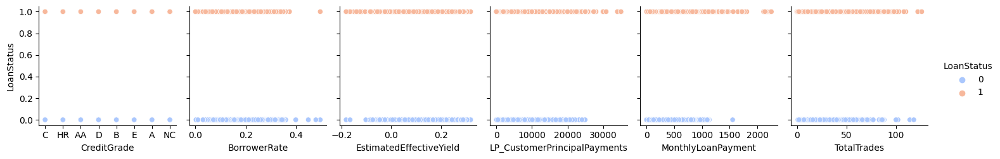

In [32]:
sns.pairplot(
    data,
    x_vars=["CreditGrade",  "BorrowerRate","EstimatedEffectiveYield","LP_CustomerPrincipalPayments","MonthlyLoanPayment","TotalTrades"],
    y_vars=["LoanStatus"],hue='LoanStatus',
    palette='coolwarm'
)


In [33]:
ex.pie(data,names='CreditGrade',width=500,height=500)

In [34]:
data.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 113937 entries, 0 to 113936
Columns: 111 entries, ListingKey to LoanOriginationDate_second
dtypes: bool(3), float64(50), int32(1), int64(47), object(10)
memory usage: 94.6+ MB


In [35]:
for col in data.select_dtypes(include=['object','bool']).columns:
  label_encoder = preprocessing.LabelEncoder()
  label_encoder.fit(data[col].unique())
  data[col]=label_encoder.transform(data[col])

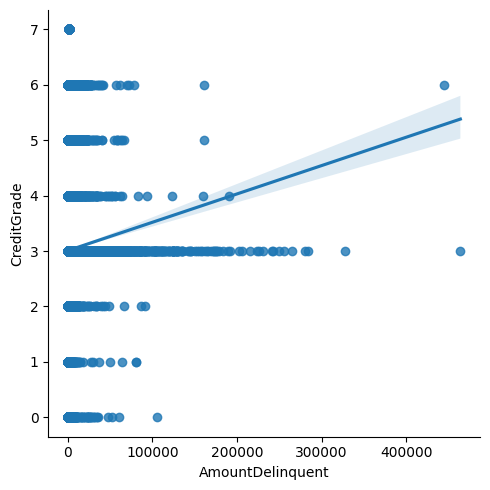

In [36]:
sns.lmplot(x='AmountDelinquent',y='CreditGrade',data=data)

<AxesSubplot: xlabel='CreditGrade', ylabel='count'>

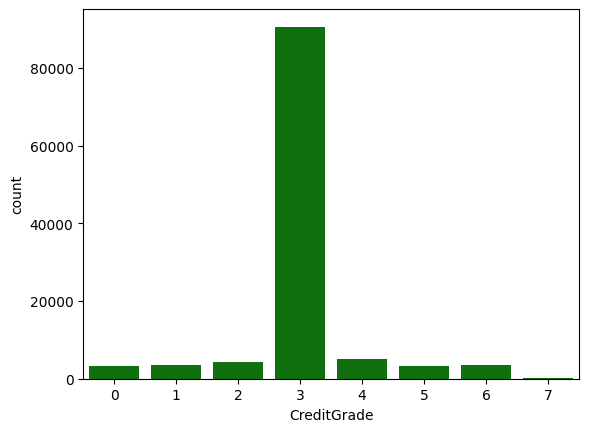

In [37]:
sns.countplot(x='CreditGrade',data=data, color='green')


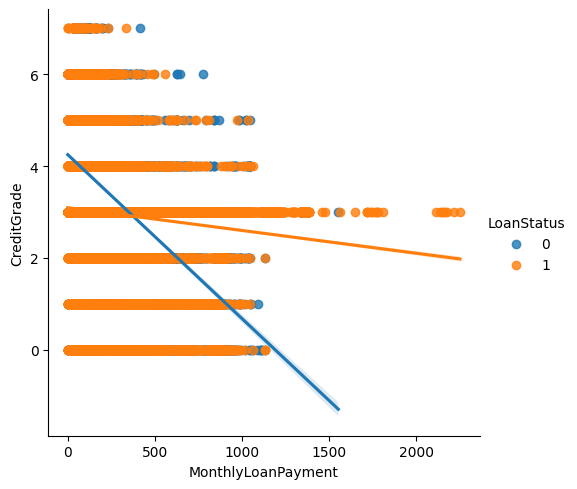

In [38]:
sns.lmplot(x='MonthlyLoanPayment',y='CreditGrade',hue='LoanStatus',data=data)

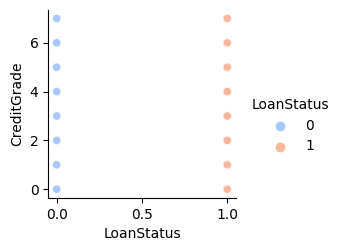

In [39]:
sns.pairplot(
    data,
    x_vars=["LoanStatus"],hue='LoanStatus',
    y_vars=["CreditGrade"],
    palette='coolwarm'
)

In [40]:
tips=data[["ProsperScore","BorrowerRate","BorrowerAPR","LoanStatus"]]


<Figure size 0x500 with 0 Axes>

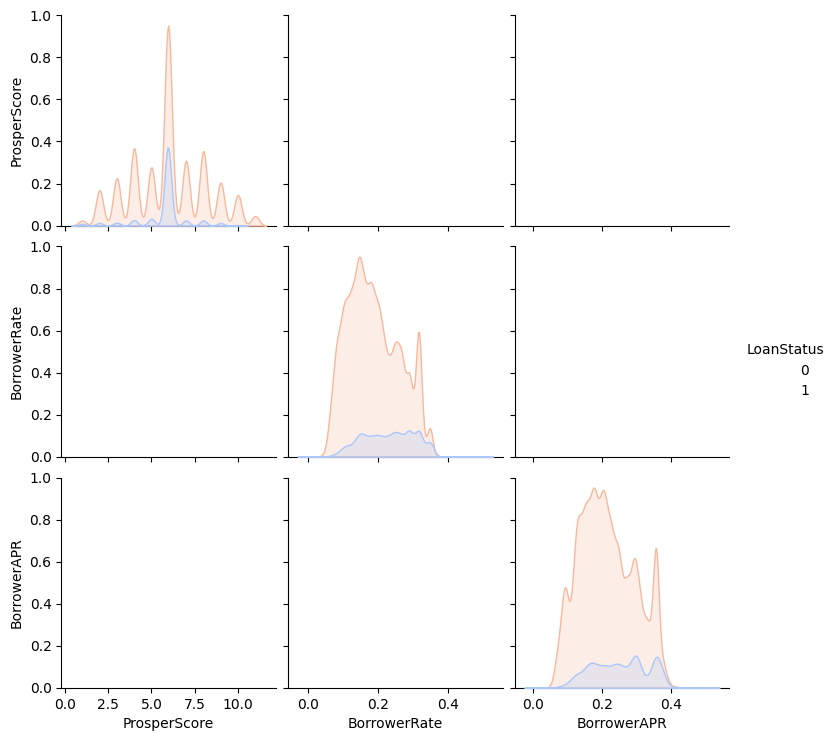

In [41]:
plt.figure(figsize=(0,5))
sns.pairplot(tips,kind='line',palette='coolwarm',hue='LoanStatus')

In [42]:
features = data.select_dtypes(include=np.number)
col= features.columns
numeric_features = list(col) 

In [43]:

data.shape
data.head(113937)

,ListingKey,ListingNumber,CreditGrade,Term,LoanStatus,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,...,ListingCreationDate_year,ListingCreationDate_hour,ListingCreationDate_minute,ListingCreationDate_second,LoanOriginationDate_day,LoanOriginationDate_month,LoanOriginationDate_year,LoanOriginationDate_hour,LoanOriginationDate_minute,LoanOriginationDate_second
0,7179,193129,3,36,1,0.16516,0.1580,0.1380,0.168661,0.080306,...,2007,19,9,29,12,9,2007,0,0,0
1,7192,1209647,3,36,1,0.12016,0.0920,0.0820,0.079600,0.024900,...,2014,8,28,7,3,3,2014,0,0,0
2,6646,81716,6,36,1,0.28269,0.2750,0.2400,0.168661,0.080306,...,2007,15,0,47,17,1,2007,0,0,0
3,6668,658116,3,36,1,0.12528,0.0974,0.0874,0.084900,0.024900,...,2012,11,2,35,1,11,2012,0,0,0
4,6685,909464,3,36,1,0.24614,0.2085,0.1985,0.183160,0.092500,...,2013,18,38,39,20,9,2013,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113932,101833,753087,3,36,1,0.22354,0.1864,0.1764,0.164900,0.069900,...,2013,5,55,2,22,4,2013,0,0,0
113933,101842,537216,3,36,1,0.13220,0.1110,0.1010,0.100700,0.020000,...,2011,20,42,55,7,11,2011,0,0,0
113934,101851,1069178,3,60,1,0.23984,0.2150,0.2050,0.188280,0.102500,...,2013,5,49,12,23,12,2013,0,0,0
113935,101868,539056,3,60,1,0.28408,0.2605,0.2505,0.244500,0.085000,...,2011,13,18,26,21,11,2011,0,0,0


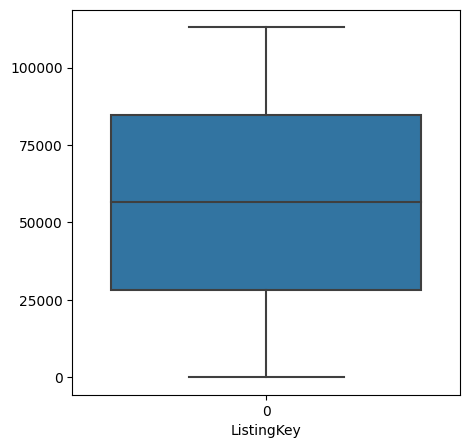

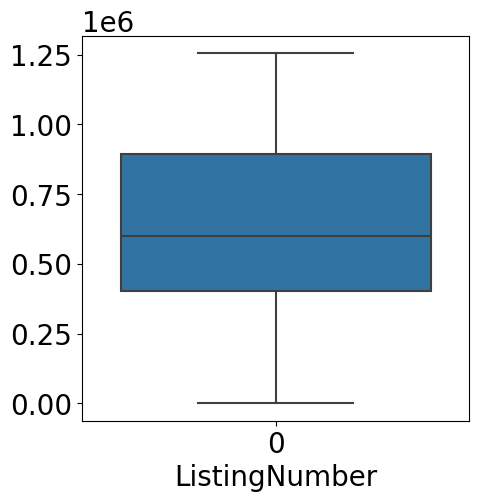

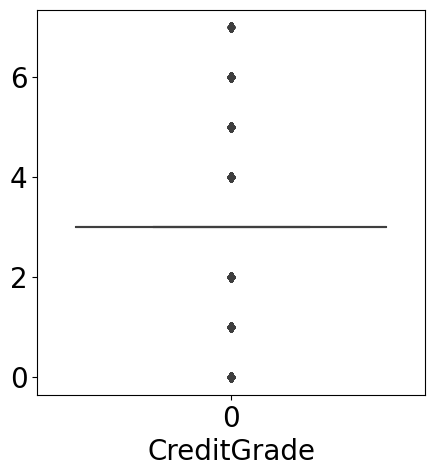

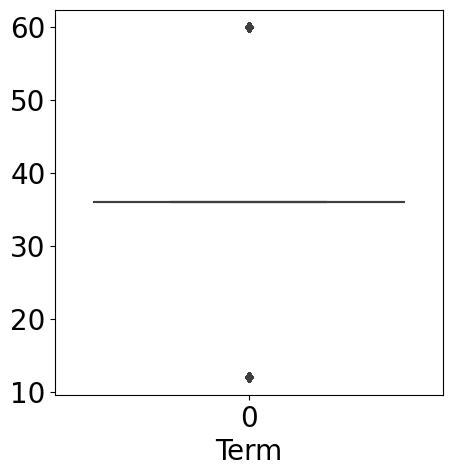

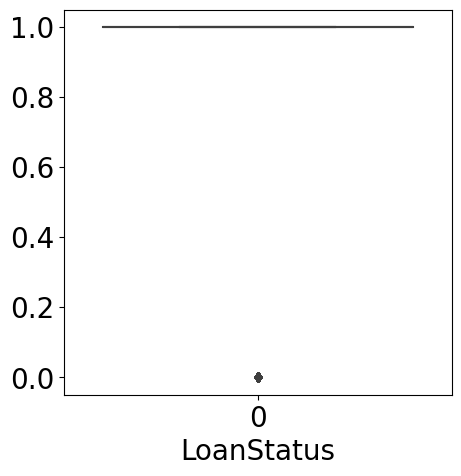

...

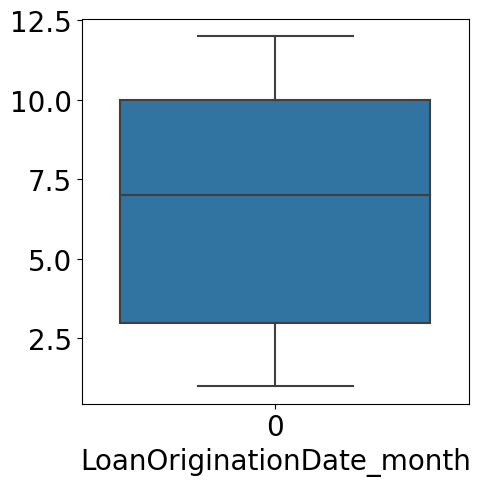

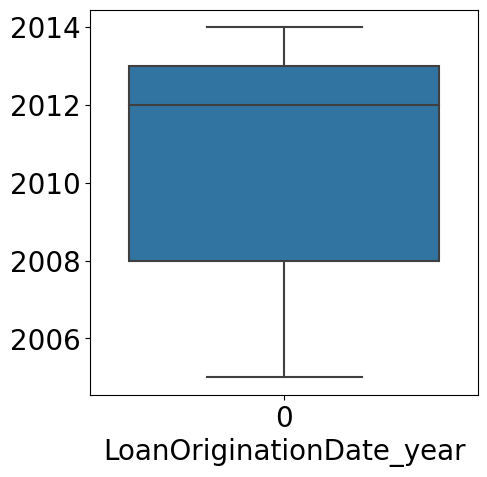

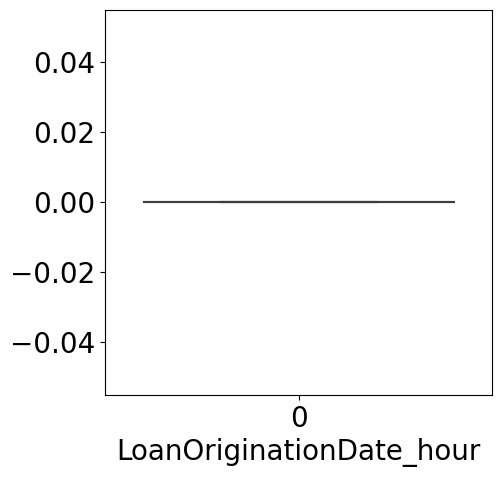

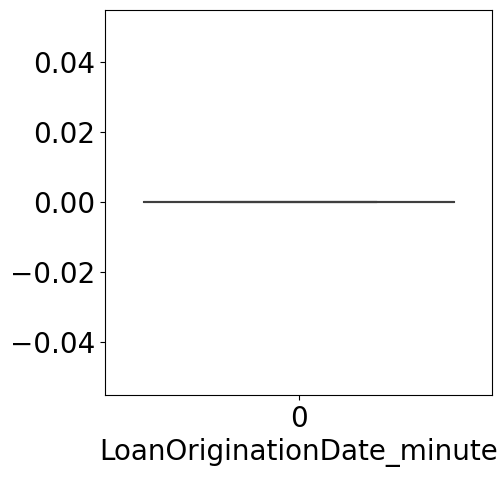

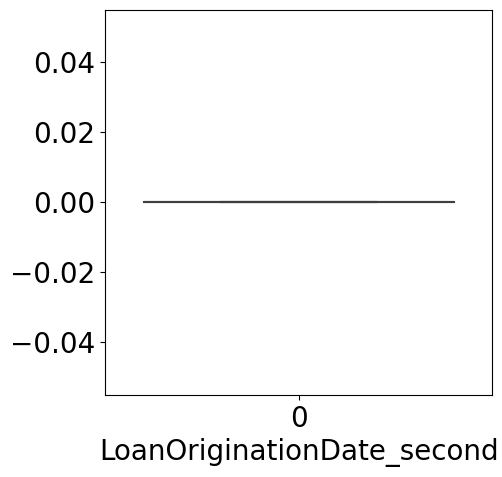

In [44]:
for feature in features :
    fig = plt.subplots(figsize=(5, 5))
    plt.rcParams.update({'font.size': 20})
    sns.boxplot(data[feature])
    plt.xlabel(feature)
    plt.show()

<AxesSubplot: >

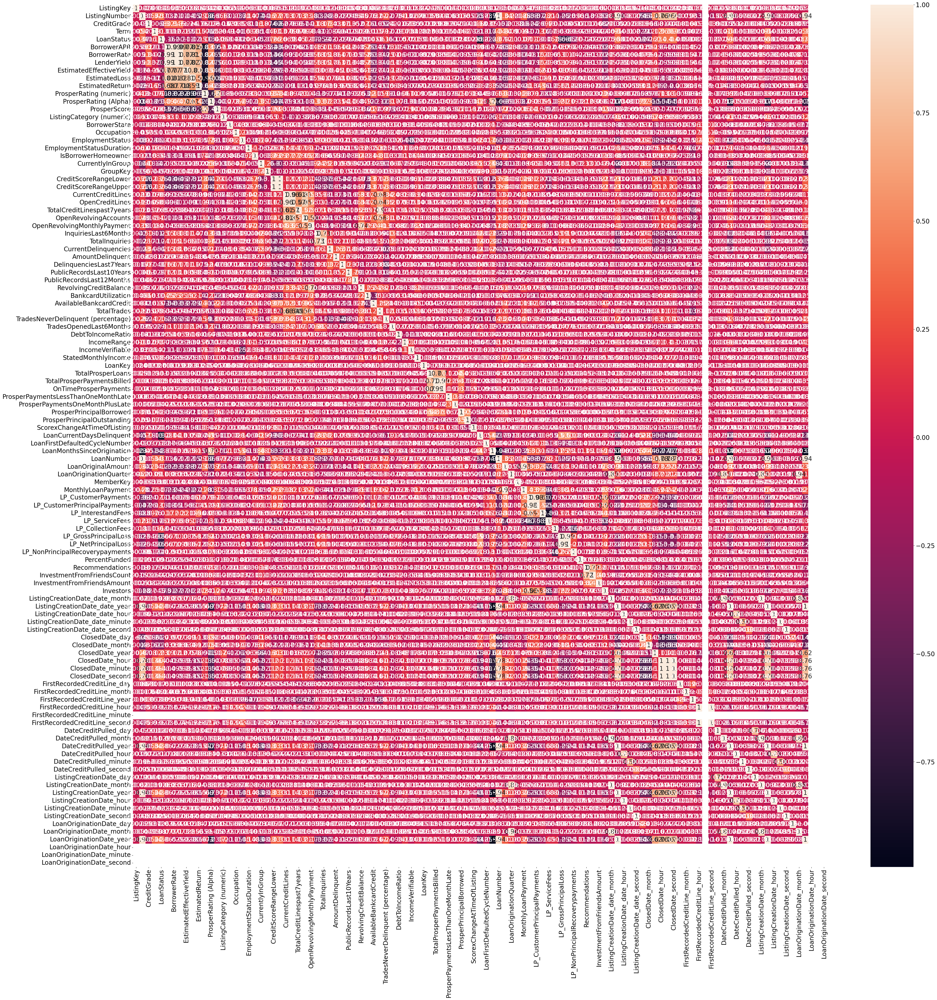

In [45]:
plt.subplots(figsize=(50,50))
sns.heatmap(data.corr(),annot=True)

In [46]:
(data < 0).any()

ListingKey                    False
ListingNumber                 False
CreditGrade                   False
Term                          False
LoanStatus                    False
                              ...  
LoanOriginationDate_month     False
LoanOriginationDate_year      False
LoanOriginationDate_hour      False
LoanOriginationDate_minute    False
LoanOriginationDate_second    False
Length: 111, dtype: bool

In [47]:
data.drop(["LP_InterestandFees","LP_ServiceFees"],axis=1,inplace=True)

In [48]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113937 entries, 0 to 113936
Columns: 109 entries, ListingKey to LoanOriginationDate_second
dtypes: float64(48), int32(11), int64(50)
memory usage: 94.9 MB
